In [1]:
#!pip install ipynb-path
import ipynb_path
import sys 
import os
__file__ = ipynb_path.get()
sys.path.append(os.path.abspath(os.path.join(os.path.dirname(__file__), '..','dbittools','Analysis','Python','read_dbit')))
import read_dbit
import numpy as np
import scanpy as sc
import squidpy as sq
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
datadir = os.path.abspath(os.path.join(os.path.dirname(__file__), '..','..','..','data','processed','A22-1650_ONH_01'))

In [3]:
# Must include a library_id name (for plotting below)
adata = read_dbit.read_dbit(path=datadir, count_file='count_file.tsv', library_id="ONH1650_1", load_images=True)
adata.uns['spatial']['ONH1650_1']['scalefactors']['tissue_lowres_scalef'] = 0.725
adata.uns['spatial'][list(adata.uns['spatial'].keys())[0]]['scalefactors']['spot_diameter_real_um'] = 25

/Users/mmd47/Dropbox/Yale/DiStasioLab/OpticNerveHead_DBiT/data/processed/A22-1650_ONH_01/spatial/intersections_matx.txt
/Users/mmd47/Dropbox/Yale/DiStasioLab/OpticNerveHead_DBiT/data/processed/A22-1650_ONH_01/spatial/tissue_positions_list.csv
None
Using intersections_matx.txt


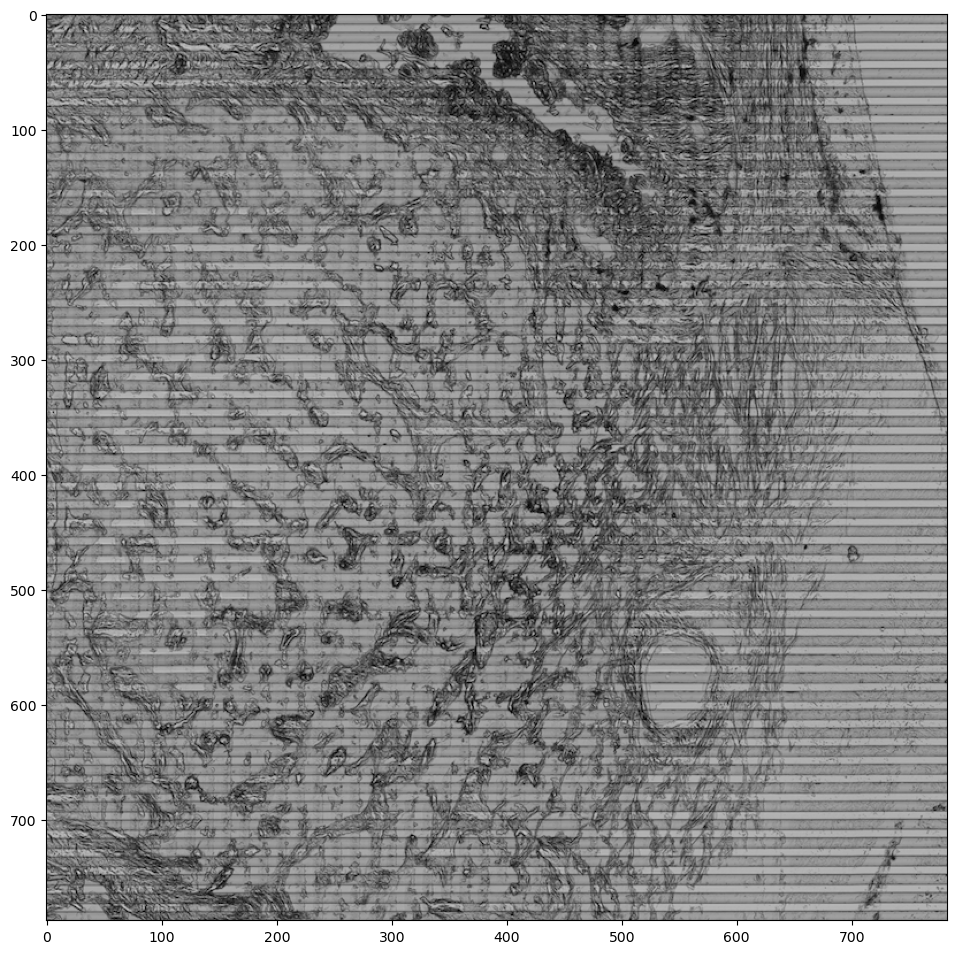

In [4]:
plt.rcParams['figure.figsize'] = [12, 12]
plt.rcParams['figure.dpi'] = 100 
plt.imshow(adata.uns['spatial']['ONH1650_1']['images']['lowres'])

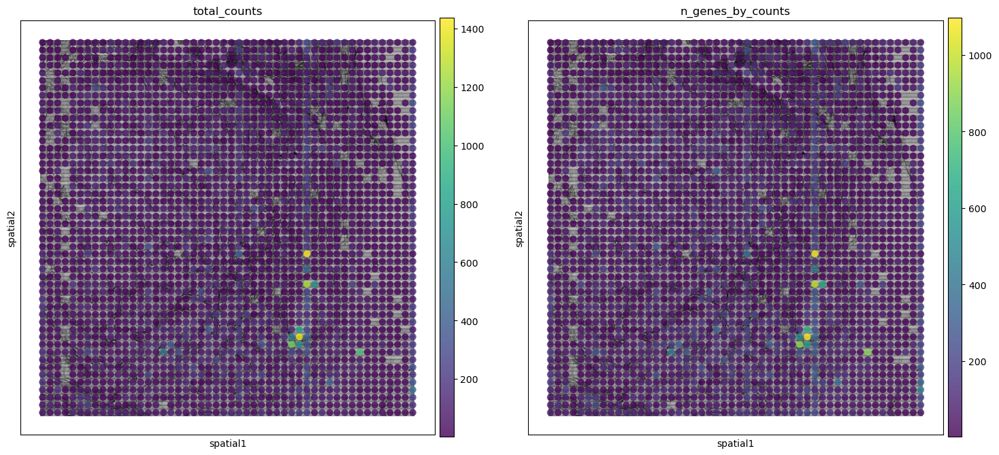

/Users/mmd47/miniconda3/envs/dbitseq/lib/python3.10/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='n_genes_by_counts'>

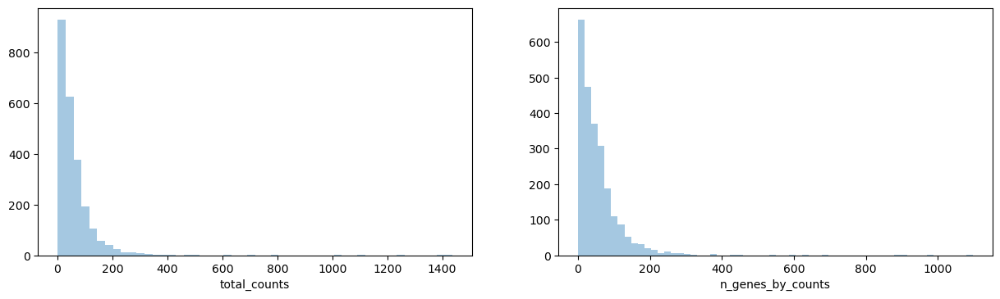

In [5]:

sc.pp.calculate_qc_metrics(adata, inplace=True)
plt.rcParams["figure.figsize"] = (8, 8)
# sc.pl.spatial(adata, img=adata.uns['spatial'][None]['images']['lowres'], 
#               color=["total_counts", "n_genes_by_counts"], spot_size=20, alpha=0.5, scale_factor=1.65)
sc.pl.spatial(adata, img_key="lowres", color=["total_counts", "n_genes_by_counts"], spot_size=20, alpha=0.8)

fig, axs = plt.subplots(1, 2, figsize=(15, 4))
sns.distplot(adata.obs["total_counts"], kde=False, ax=axs[0])
sns.distplot(adata.obs["n_genes_by_counts"], kde=False, bins=60, ax=axs[1])


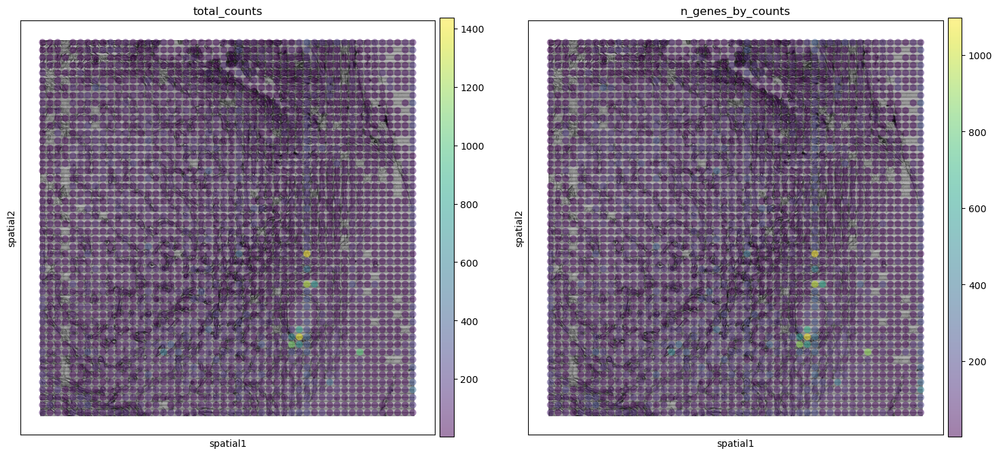

In [6]:
sc.pl.spatial(adata, img_key='lowres', color=["total_counts", "n_genes_by_counts"], spot_size=20, alpha=0.5)

In [7]:
sc.pp.filter_cells(adata, min_counts=10)
sc.pp.filter_cells(adata, max_counts=1500)
sc.pp.filter_genes(adata, min_cells=2)

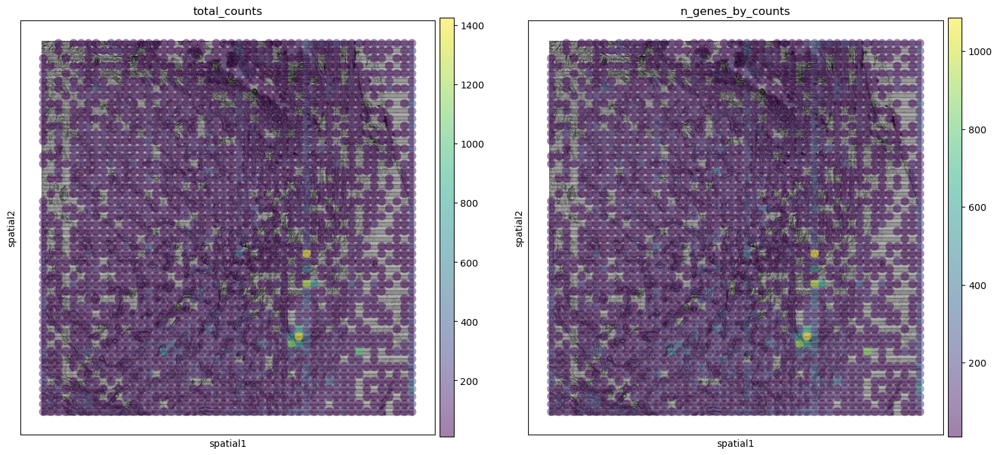

In [8]:
sc.pp.calculate_qc_metrics(adata, inplace=True)
plt.rcParams["figure.figsize"] = (8, 8)
sc.pl.spatial(adata, img_key="lowres", color=["total_counts", "n_genes_by_counts"], spot_size=25, alpha=0.5)

In [9]:
# MAGIC
import magic
import scprep
magic_operator = magic.MAGIC()

#onh = adata.to_df()

onhn = scprep.normalize.library_size_normalize(adata.to_df())
onh_magic = magic_operator.fit_transform(onhn, genes='all_genes')

adatam = adata.copy()
adatam.X = onh_magic

Calculating MAGIC...
  Running MAGIC on 2048 cells and 4033 genes.
  Calculating graph and diffusion operator...
    Calculating PCA...
    Calculated PCA in 0.72 seconds.
    Calculating KNN search...
    Calculated KNN search in 0.30 seconds.
    Calculating affinities...
    Calculated affinities in 0.30 seconds.
  Calculated graph and diffusion operator in 1.32 seconds.
  Calculating imputation...
  Calculated imputation in 0.31 seconds.
Calculated MAGIC in 1.64 seconds.


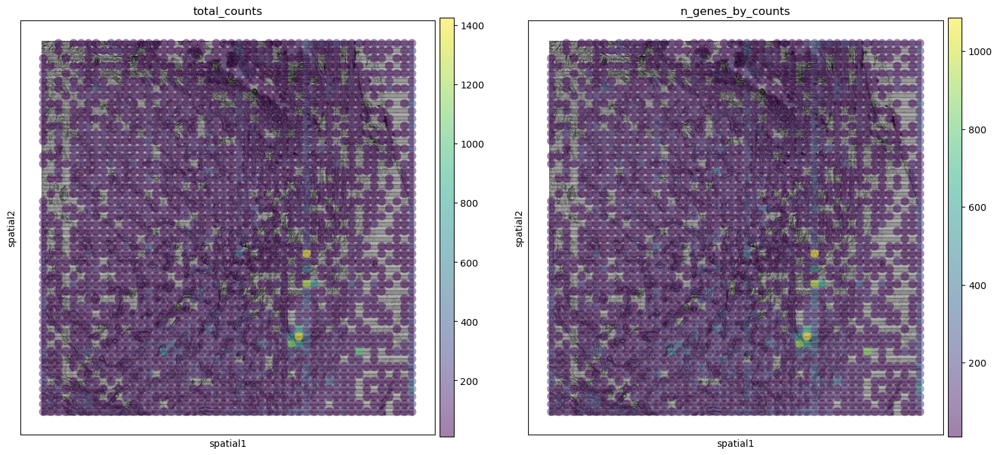

In [32]:
sc.pp.calculate_qc_metrics(adata, inplace=True)
plt.rcParams["figure.figsize"] = (8, 8)
sc.pl.spatial(adatam, img_key="lowres", color=["total_counts", "n_genes_by_counts"], spot_size=25, alpha=0.5)

In [ ]:
sc.pp.calculate_qc_metrics(adata, inplace=True)
plt.rcParams["figure.figsize"] = (8, 8)
sc.pl.spatial(adatam, img_key="lowres", color=["total_counts", "n_genes_by_counts"], spot_size=25, alpha=0.5)

In [10]:
import phate
data_phate = phate.PHATE().fit_transform(adata)



Calculating PHATE...
  Running PHATE on 2048 observations and 4033 variables.
  Calculating graph and diffusion operator...
    Calculating PCA...
    Calculated PCA in 0.63 seconds.
    Calculating KNN search...
    Calculated KNN search in 0.31 seconds.
    Calculating affinities...
    Calculated affinities in 0.18 seconds.
  Calculated graph and diffusion operator in 1.12 seconds.
  Calculating landmark operator...
    Calculating SVD...
    Calculated SVD in 0.32 seconds.
    Calculating KMeans...
    Calculated KMeans in 1.91 seconds.
  Calculated landmark operator in 2.60 seconds.
  Calculating optimal t...
    Automatically selected t = 6
  Calculated optimal t in 3.59 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.20 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 1.46 seconds.
Calculated PHATE in 8.98 seconds.


/Users/mmd47/miniconda3/envs/dbitseq/lib/python3.10/site-packages/scprep/plot/utils.py:104: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


<AxesSubplot:xlabel='PHATE1', ylabel='PHATE2'>

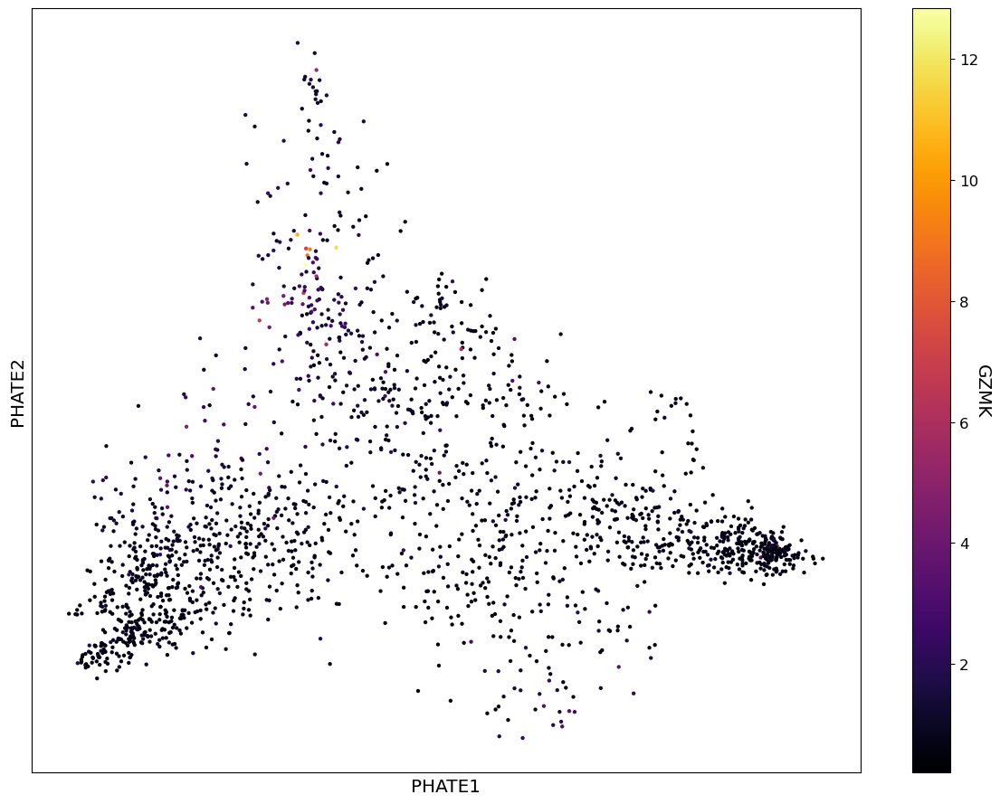

In [11]:
scprep.plot.scatter2d(data_phate, c=adatam.to_df()['GZMK'], figsize=(12,9),
                      ticks=False, label_prefix="PHATE", legend_title="GZMK")

In [12]:
adatam.to_df()['FLT1']

16x15    3.587847
45x40    4.516722
31x7     6.363708
10x1     5.119537
5x28     4.288644
           ...   
6x43     3.282017
32x19    3.320931
38x11    6.581312
18x40    2.850276
37x4     2.850314
Name: FLT1, Length: 2048, dtype: float64

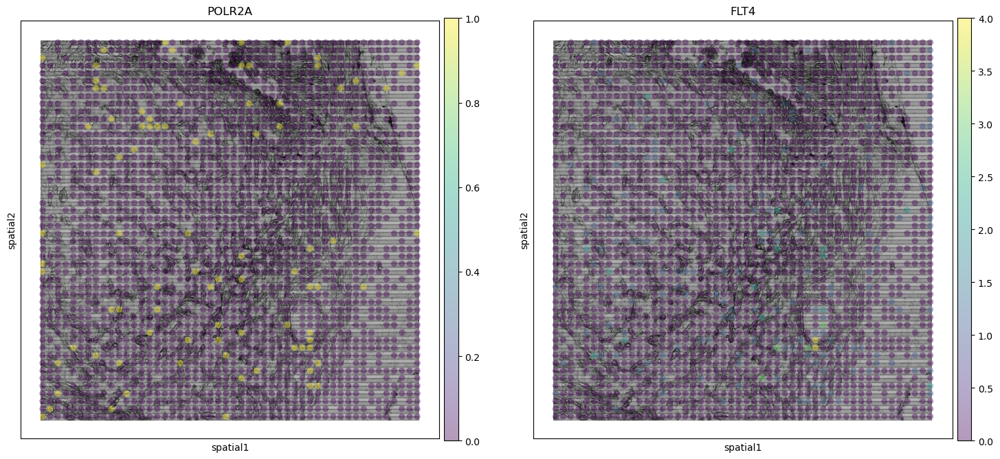

In [13]:
sc.pl.spatial(adata, img_key="lowres", color=["POLR2A","FLT4"], spot_size=18, alpha=0.4)

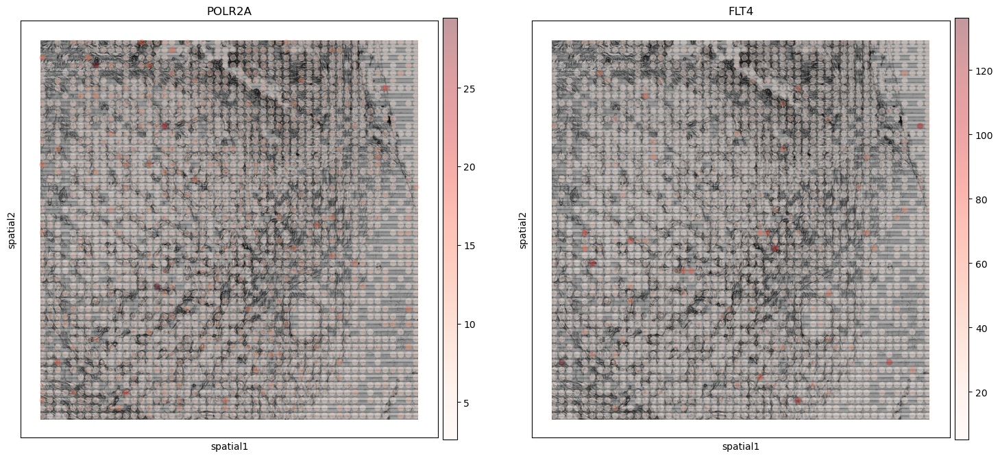

In [33]:
sc.pl.spatial(adatam, img_key="lowres", color=["POLR2A","FLT4"], spot_size=18, alpha=0.4, cmap="Reds")

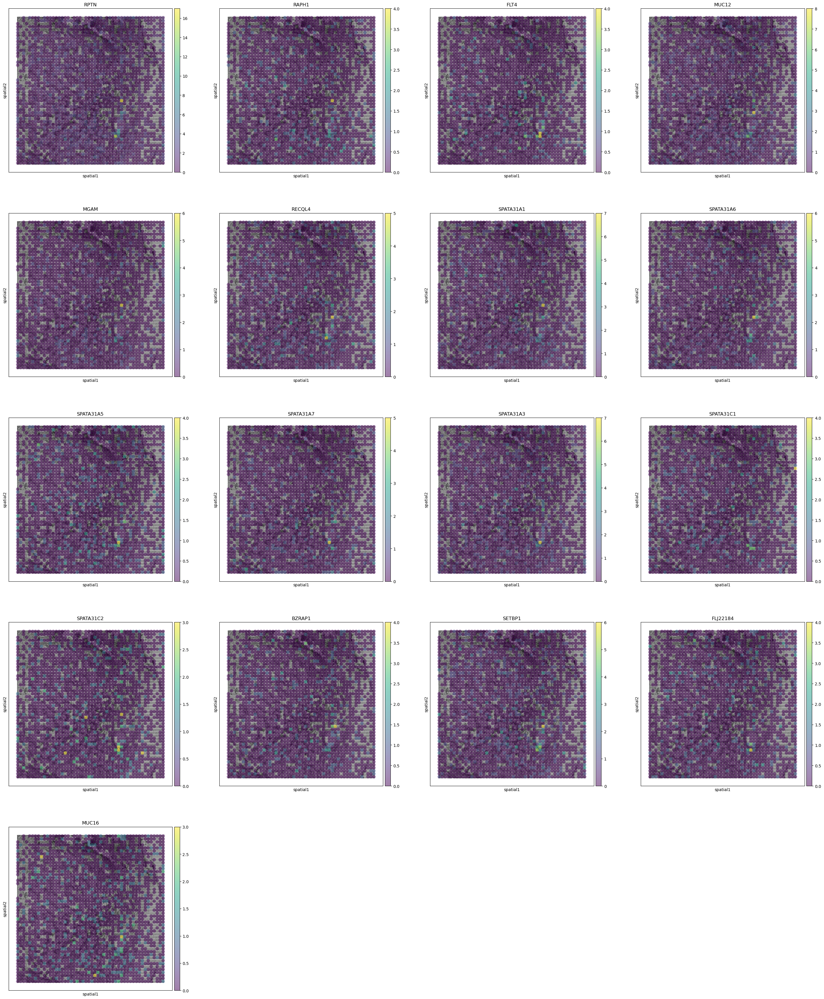

In [15]:
adata_filt = sc.pp.filter_genes(adata, min_counts=220, min_cells=None, max_counts=None, max_cells=None, inplace=False)
mygenes = adata.var_names[adata_filt[0]]
sc.pl.spatial(adata, img_key="lowres", color=mygenes, spot_size=25, alpha=0.5)

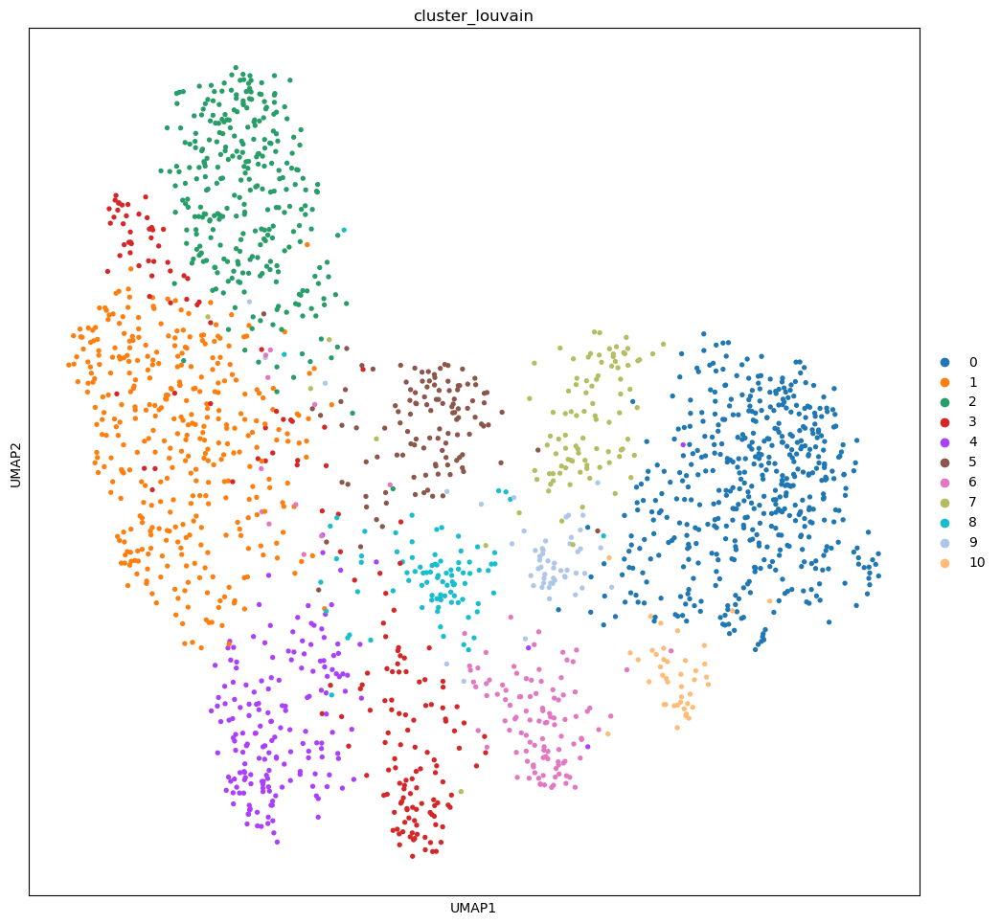

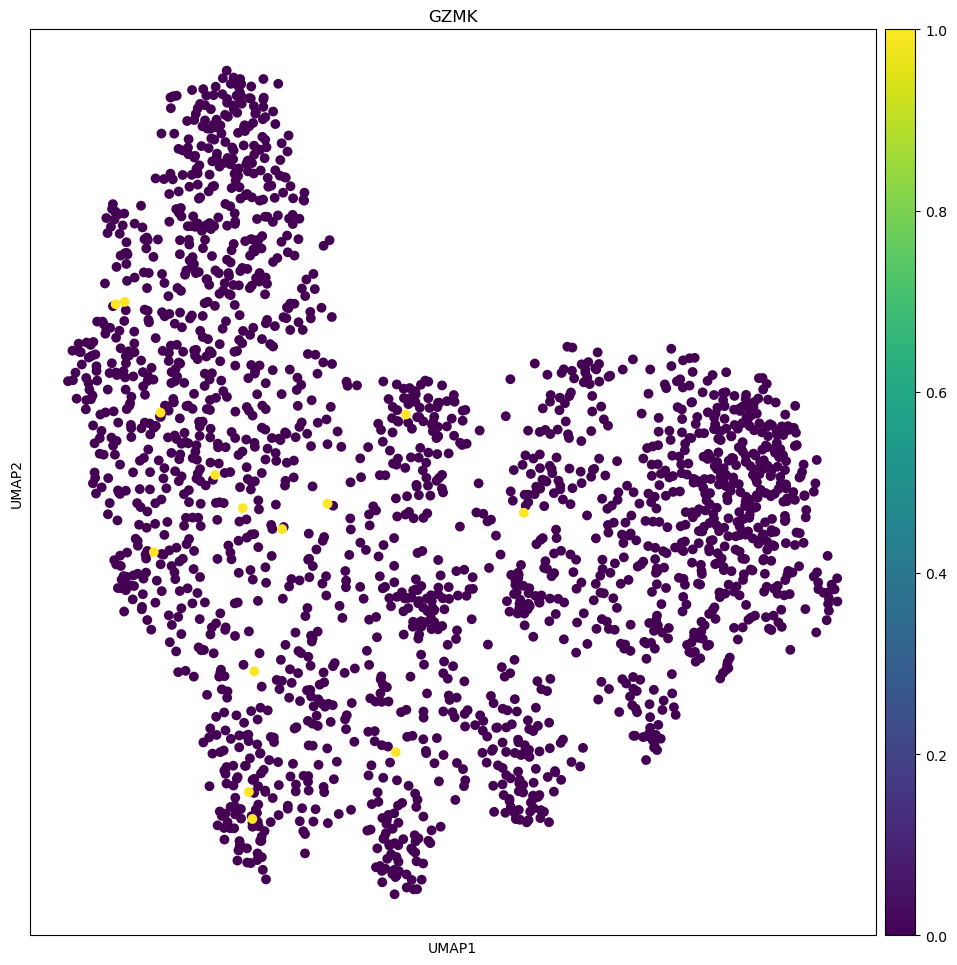

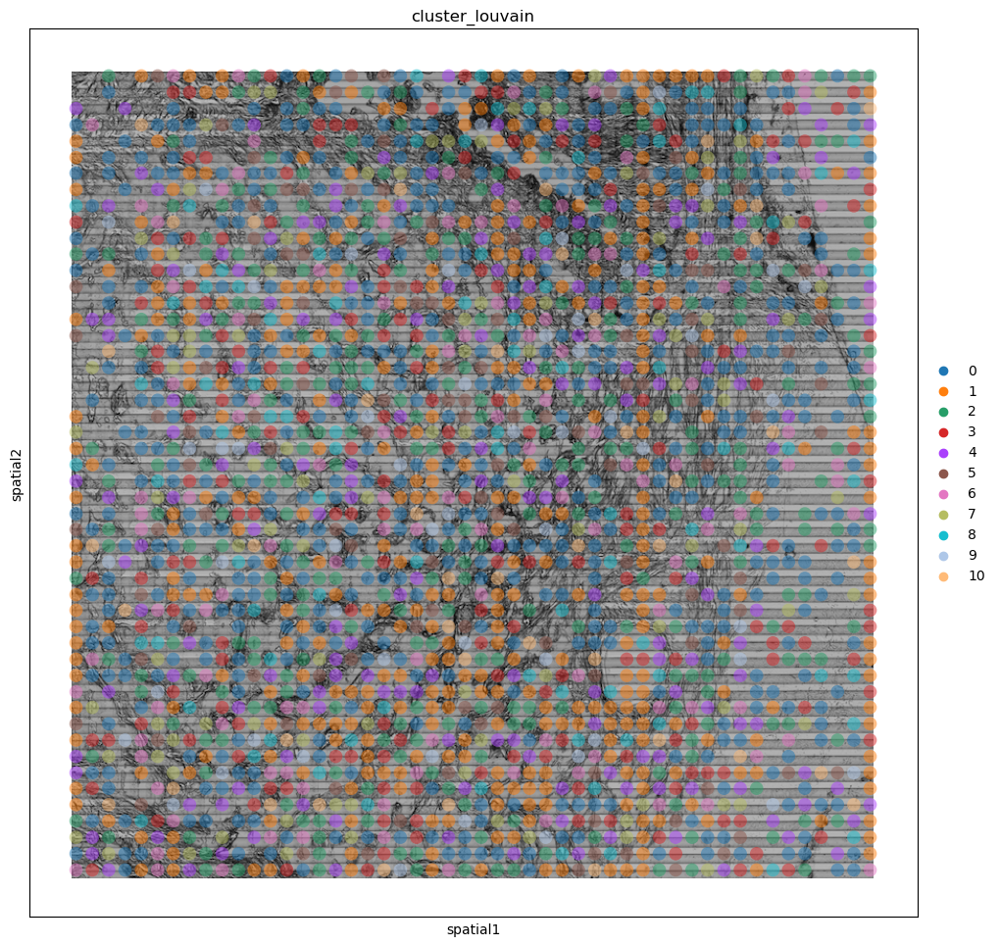

In [34]:
sc.pp.pca(adata)
sc.pp.neighbors(adata)
sc.tl.umap(adata)
#sc.tl.louvain(adatam, key_added="cluster_louvain", resolution=0.58)
sc.tl.louvain(adata, key_added="cluster_louvain", resolution=1)

plt.rcParams['figure.figsize'] = [12, 12]
plt.rcParams['figure.dpi'] = 100 
#sc.pl.umap(adatam, color=["total_counts", "n_genes_by_counts", "clusters"], wspace=0.4)
sc.pl.umap(adata, color=["cluster_louvain"])
sc.pl.umap(adata, color=["GZMK"], size=200)
sc.pl.spatial(adata, img_key="lowres", color="cluster_louvain", spot_size=18, alpha=0.5)

In [16]:
sc.pp.pca(adatam)
sc.pp.neighbors(adatam)
sc.tl.umap(adatam)
#sc.tl.louvain(adatam, key_added="cluster_louvain", resolution=0.58)
sc.tl.louvain(adatam, key_added="cluster_louvain", resolution=1)




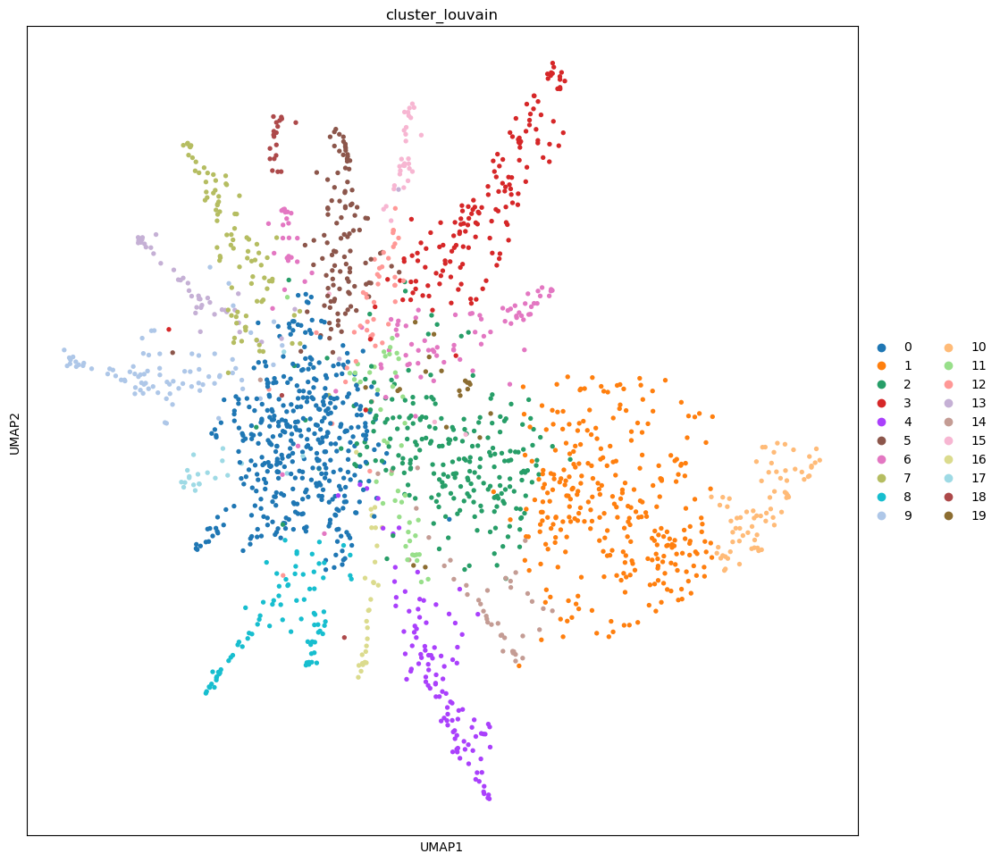

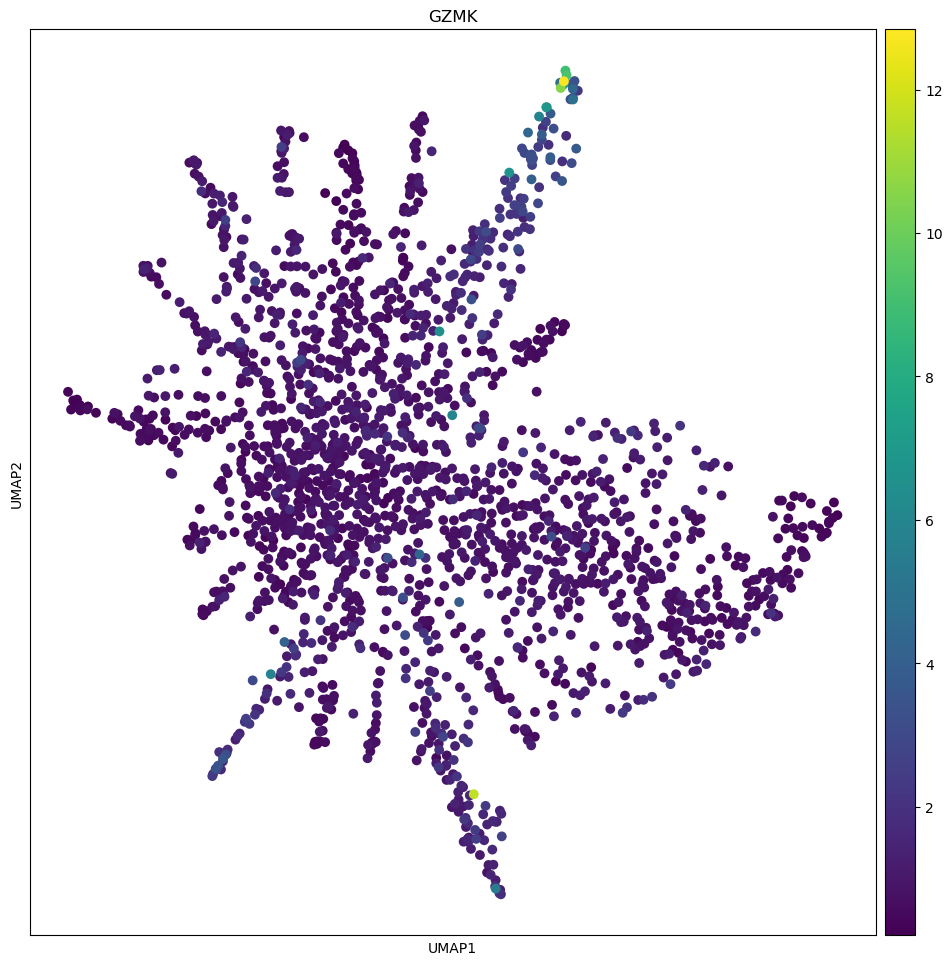

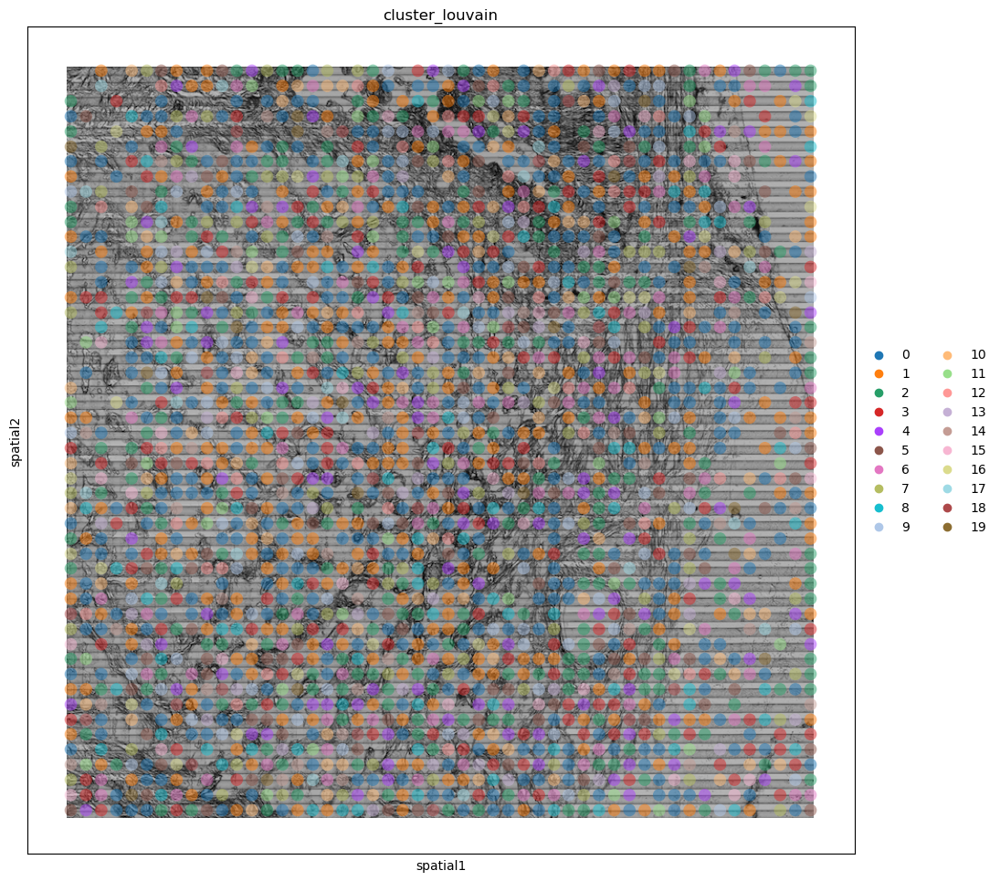

In [17]:
plt.rcParams['figure.figsize'] = [12, 12]
plt.rcParams['figure.dpi'] = 100 
#sc.pl.umap(adatam, color=["total_counts", "n_genes_by_counts", "clusters"], wspace=0.4)
sc.pl.umap(adatam, color=["cluster_louvain"])
sc.pl.umap(adatam, color=["GZMK"], size=200)
sc.pl.spatial(adatam, img_key="lowres", color="cluster_louvain", spot_size=18, alpha=0.5)

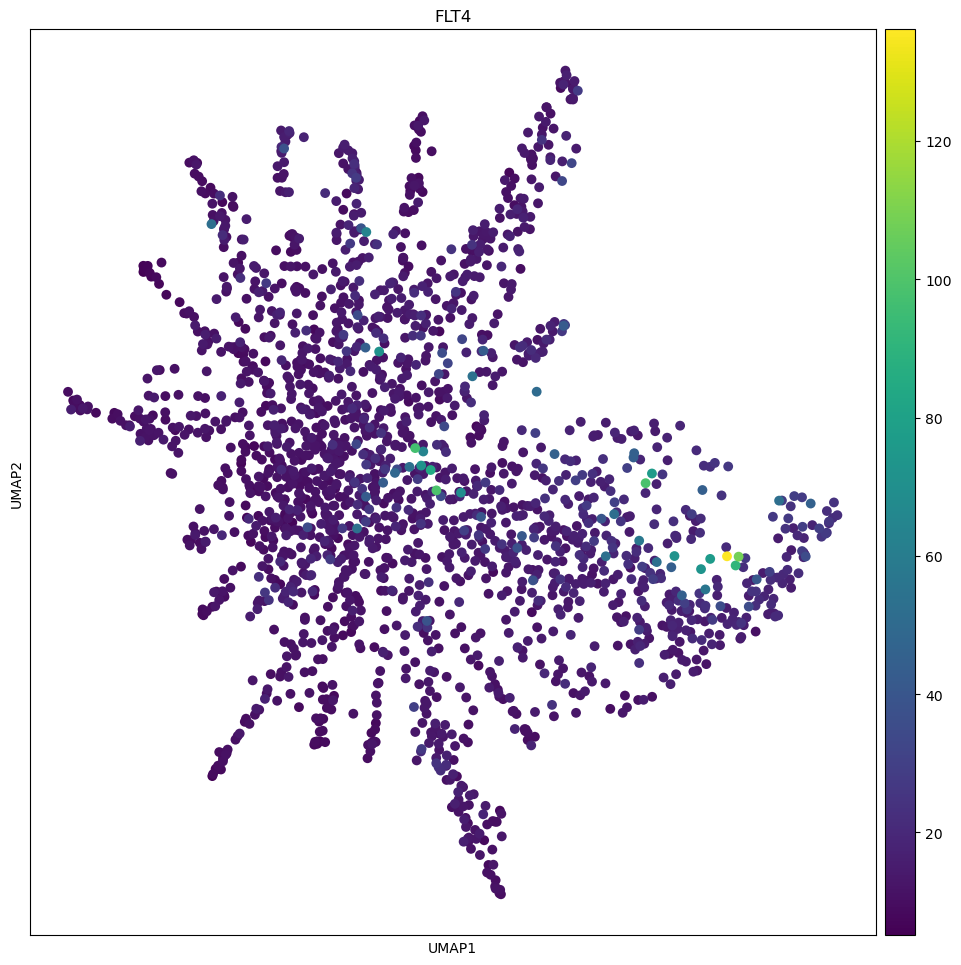

In [35]:
sc.pl.umap(adatam, color=["FLT4"], size=200)

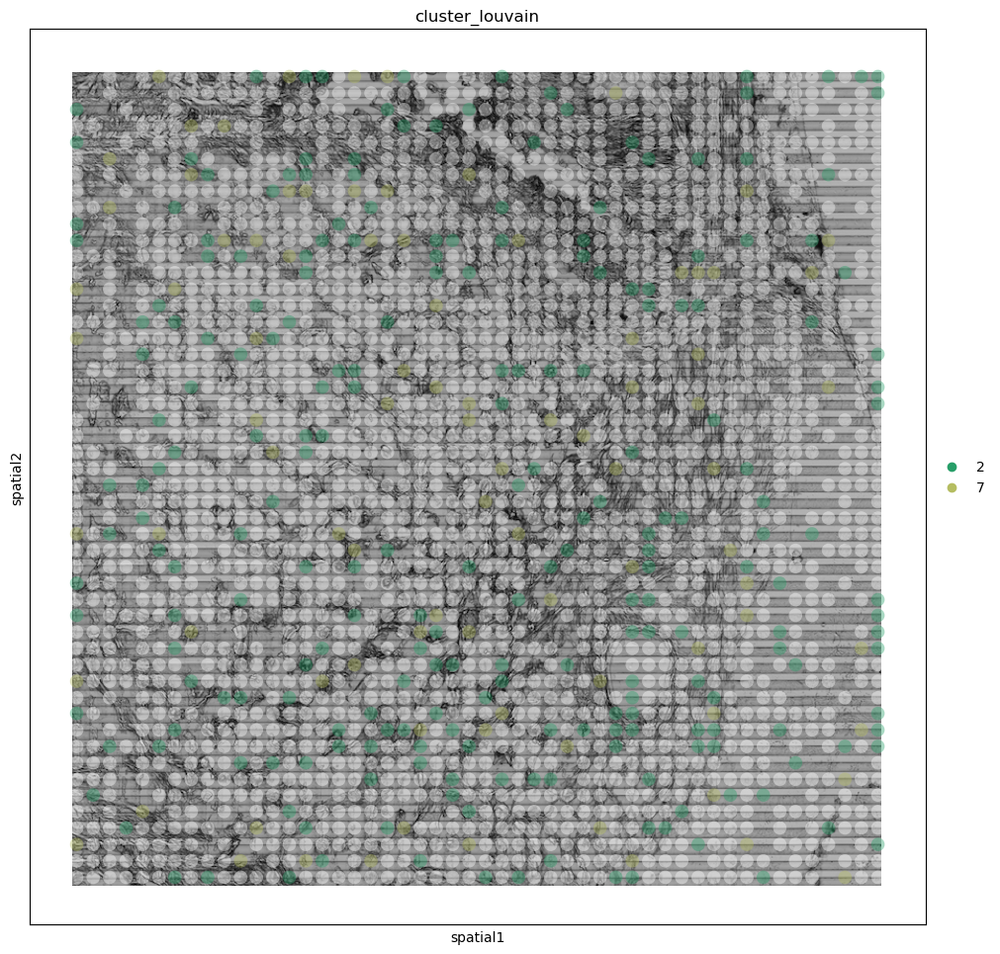

In [18]:
plt.rcParams['figure.figsize'] = [12, 12]
plt.rcParams['figure.dpi'] = 100 
sc.pl.spatial(adatam, img_key="lowres", color="cluster_louvain", spot_size=18, na_color='white', na_in_legend=False, alpha=0.4, groups=["2","7"])

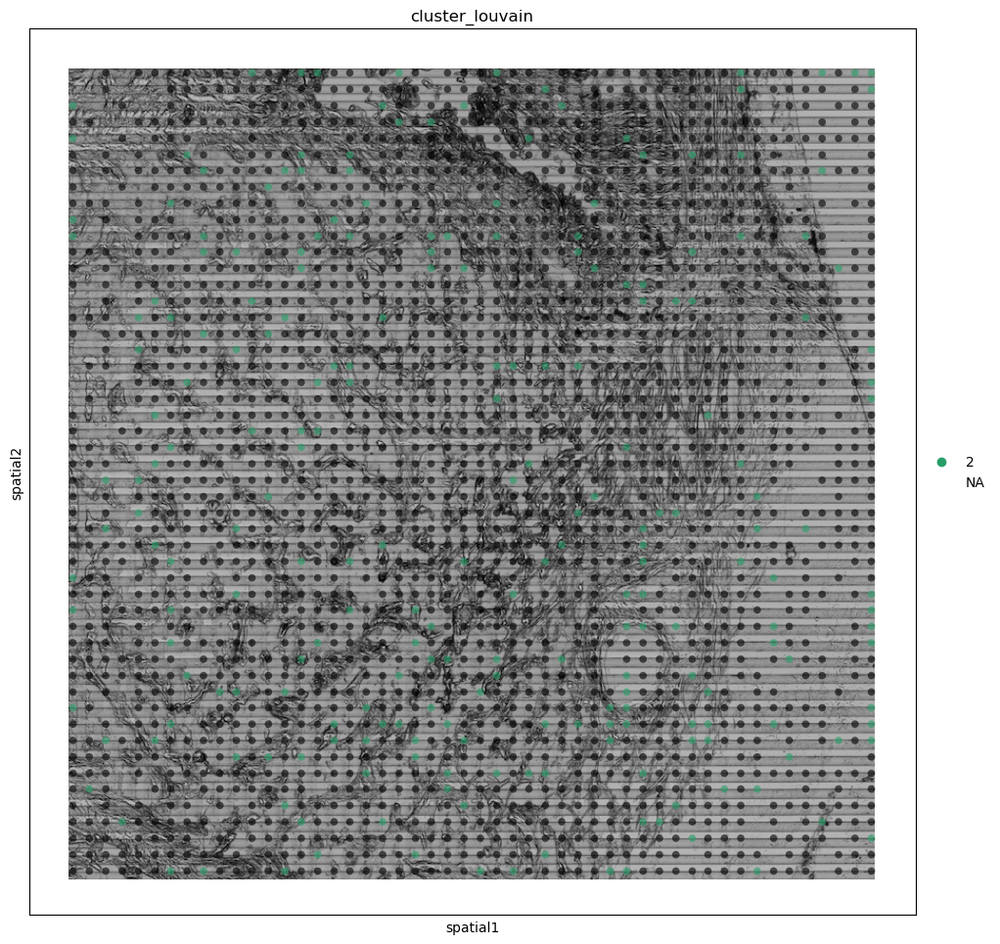

In [45]:
plt.rcParams['figure.figsize'] = [12, 12]
plt.rcParams['figure.dpi'] = 100 
sc.pl.spatial(adatam, img_key="lowres", color="cluster_louvain", spot_size=10, alpha=0.6, groups=["2"])

categories: 0, 1, 2, etc.
var_group_labels: Neuron, Other, T-cell


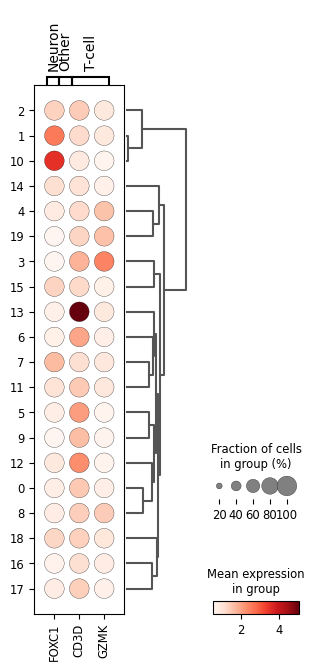

In [20]:
marker_genes_dict = {
    'Neuron': ['FOXC1'],
    'Other': [],
    'T-cell': ['CD3D',"GZMK"],
}

sc.tl.dendrogram(adatam, groupby='cluster_louvain')

sc.pl.dotplot(adatam, marker_genes_dict, 'cluster_louvain', dendrogram=True)

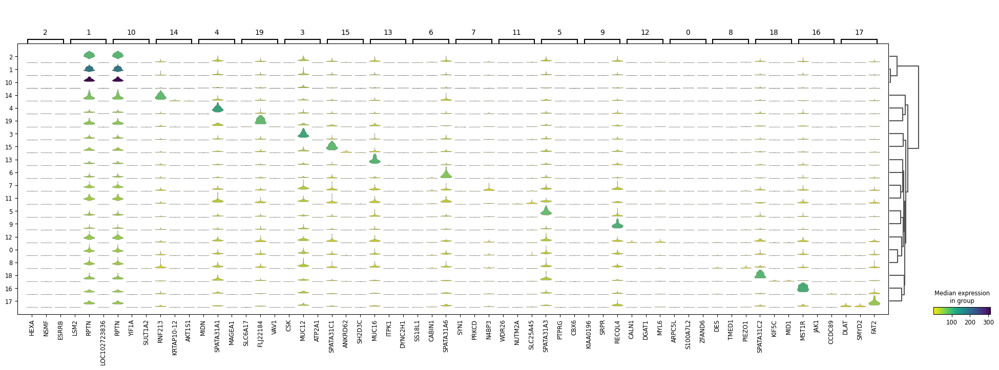

In [21]:

sc.tl.rank_genes_groups(adatam, groupby='cluster_louvain', method='wilcoxon')
sc.pl.rank_genes_groups_stacked_violin(adatam, n_genes=3, cmap='viridis_r')

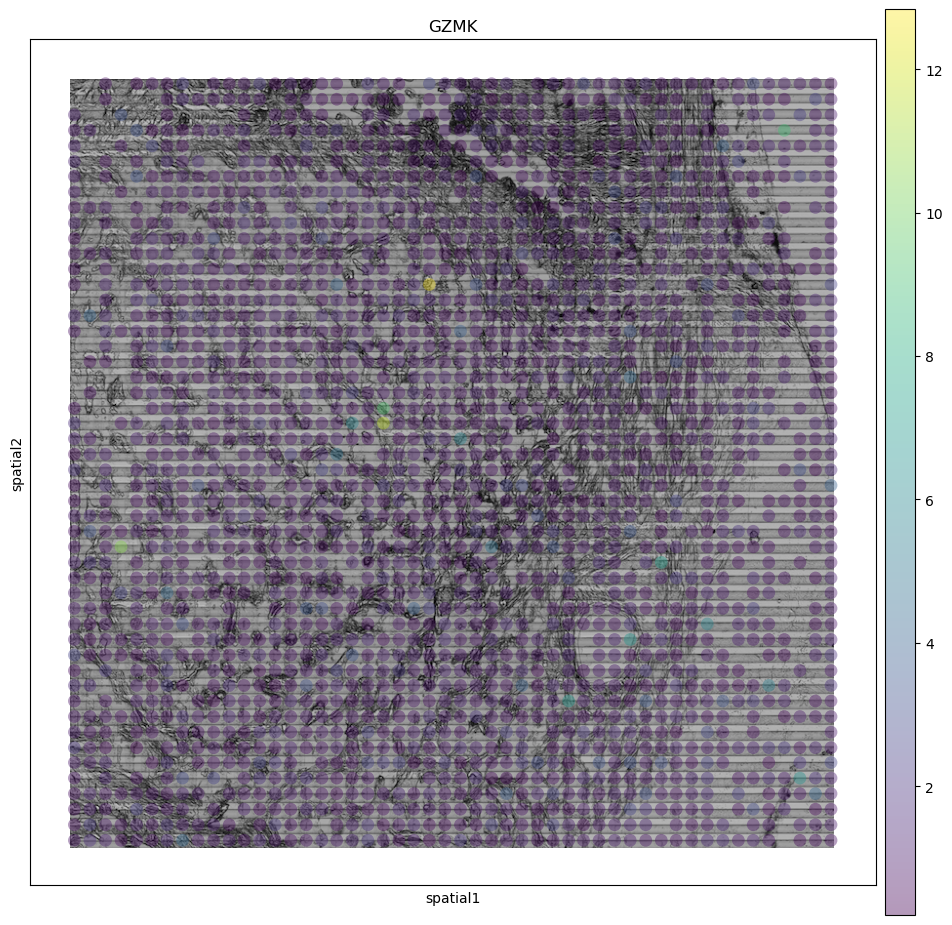

In [22]:
plt.rcParams['figure.figsize'] = [12, 12]
plt.rcParams['figure.dpi'] = 100 
sc.pl.spatial(adatam, img_key="lowres", color=["GZMK"], spot_size=18, alpha=0.4)

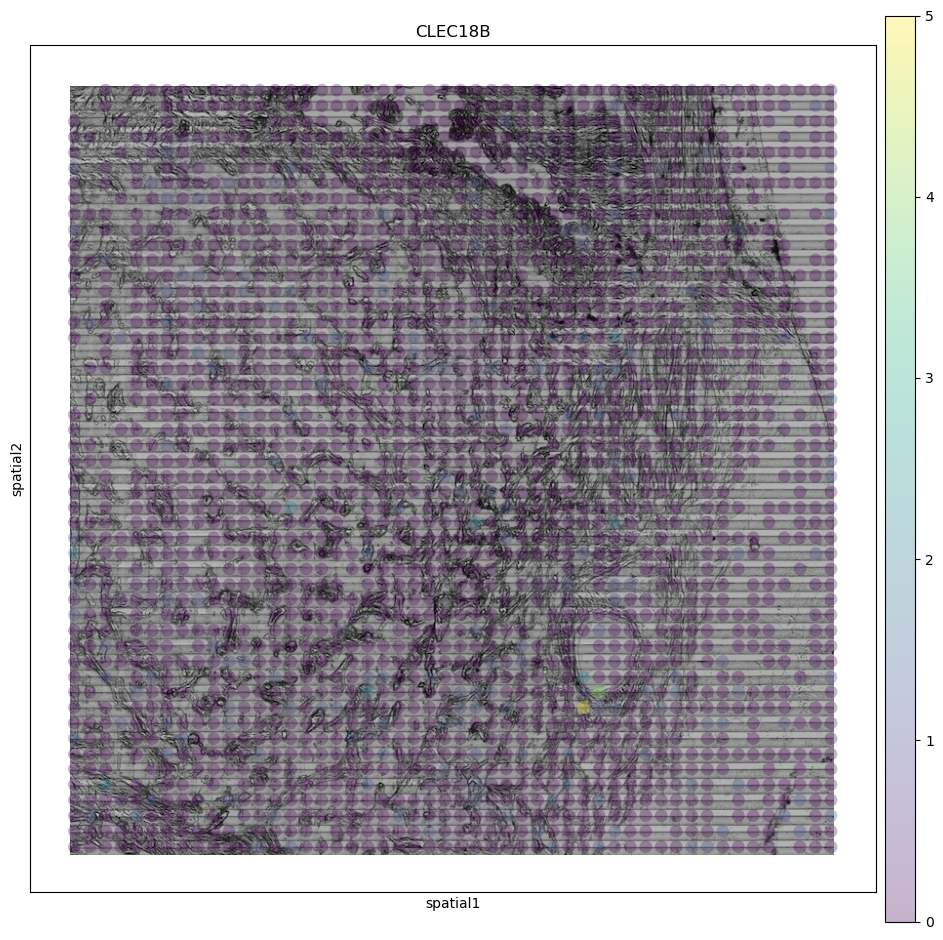

In [23]:
sc.pl.spatial(adata, img_key="lowres", color=["CLEC18B"], spot_size=18, alpha=0.3)

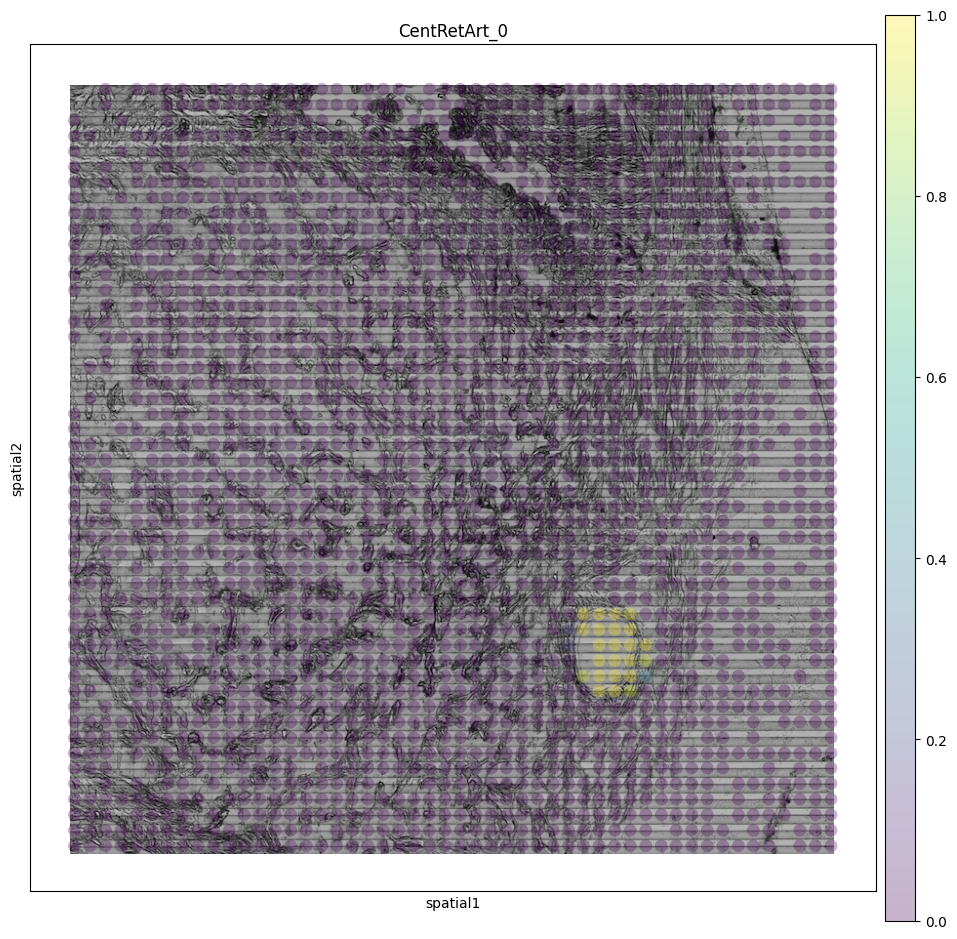

In [24]:
plt.rcParams['figure.figsize'] = [12, 12]
plt.rcParams['figure.dpi'] = 100 
sc.pl.spatial(adata, img_key="lowres", color=['CentRetArt_0'], spot_size=18, alpha=0.3)

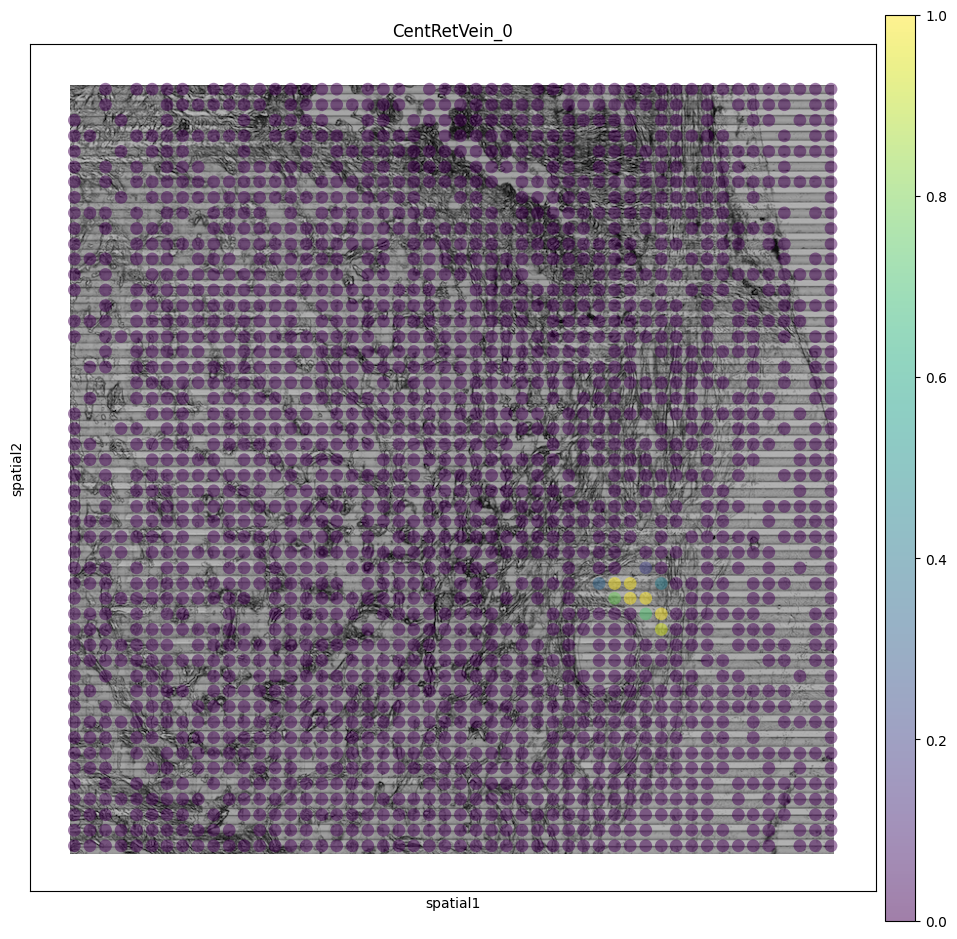

In [25]:
sc.pl.spatial(adata, img_key="lowres", color=['CentRetVein_0'], spot_size=18, alpha=0.5)

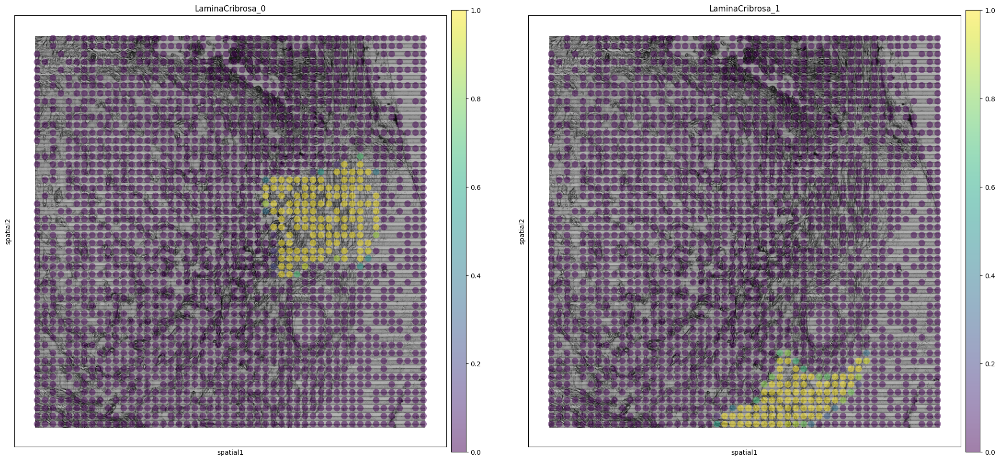

In [26]:
sc.pl.spatial(adata, img_key="lowres", color=['LaminaCribrosa_0','LaminaCribrosa_1'], spot_size=18, alpha=0.5)

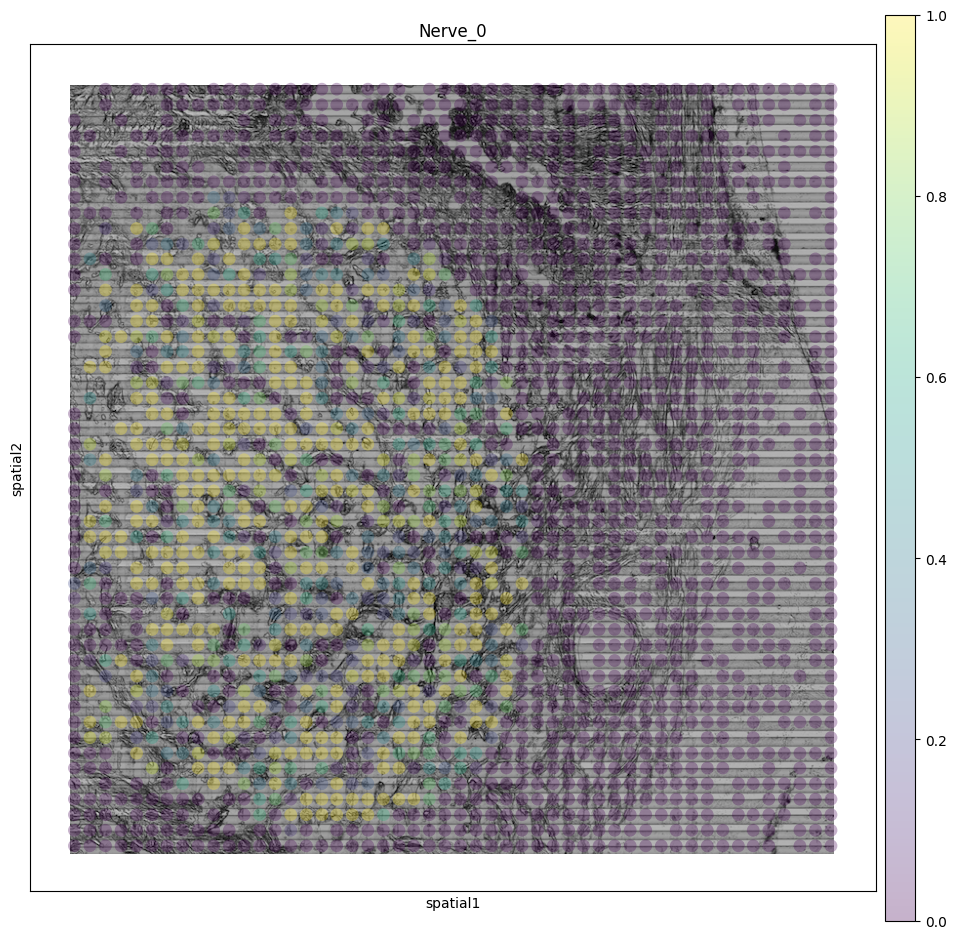

In [27]:
plt.rcParams['figure.figsize'] = [12, 12]
plt.rcParams['figure.dpi'] = 100 

sc.pl.spatial(adata, img_key="lowres", color=['Nerve_0'], spot_size=18, alpha=0.3)

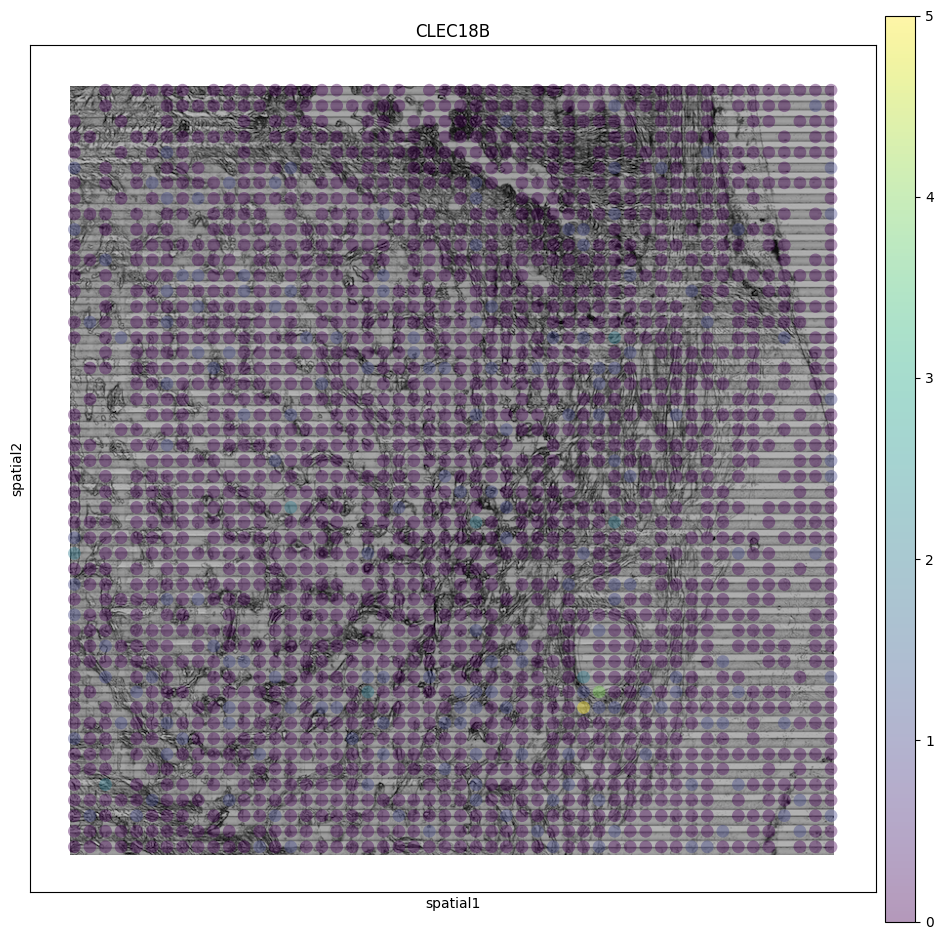

In [28]:
sc.pl.spatial(adata, img_key="lowres", color=["CLEC18B"], spot_size=18, alpha=0.4)

In [24]:
def normexprdensity(adata, genelist, regionname):
    if regionname in adata.obs_keys():
        spotdiam = adata.uns['spatial'][list(adata.uns['spatial'].keys())[0]]['scalefactors']['spot_diameter_real_um']
        
        total_expression = adata[:,genelist].to_df().multiply(adata.obs[regionname], axis="index").sum()
        total_area = sum(adata.obs[regionname] * np.square(spotdiam)) 
        
        return (np.float32(total_expression/total_area)[0])

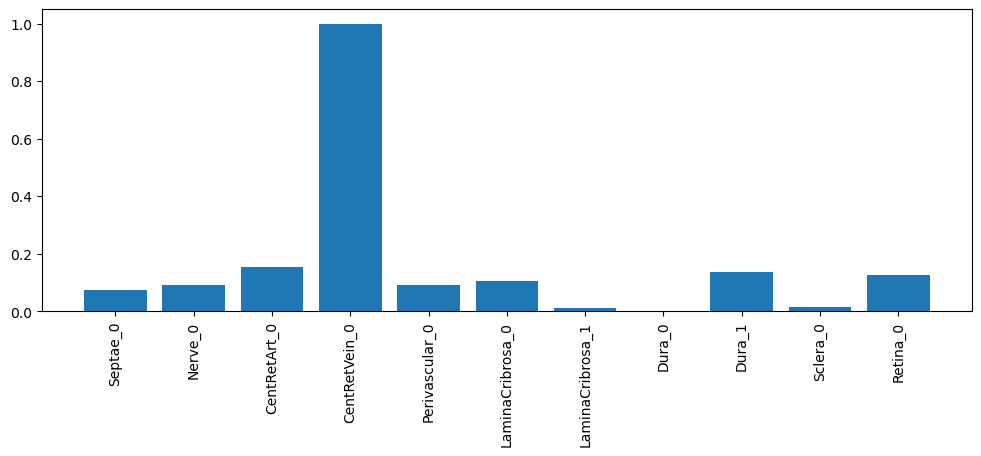

In [25]:
GENE_TO_PLOT = 'RNF213'   
    
Labels = []    
Values = []
for region in ['Septae_0',
 'Nerve_0',
 'CentRetArt_0',
 'CentRetVein_0',
 'Perivascular_0',
 'LaminaCribrosa_0',
 'LaminaCribrosa_1',
 'Dura_0',
 'Dura_1',
 'Sclera_0',
 'Retina_0',] :
        nd = normexprdensity(adata, [GENE_TO_PLOT], region)*100000
        Labels.append(region)
        Values.append(nd)

    
Values = (Values - np.min(Values))/(np.max(Values) - np.min(Values))
plt.rcParams['figure.figsize'] = [12, 4]
plt.rcParams['figure.dpi'] = 100 
plt.bar(np.arange(0,len(Labels),1), height=Values, tick_label=Labels)
plt.xticks(rotation='vertical')    
plt.show()

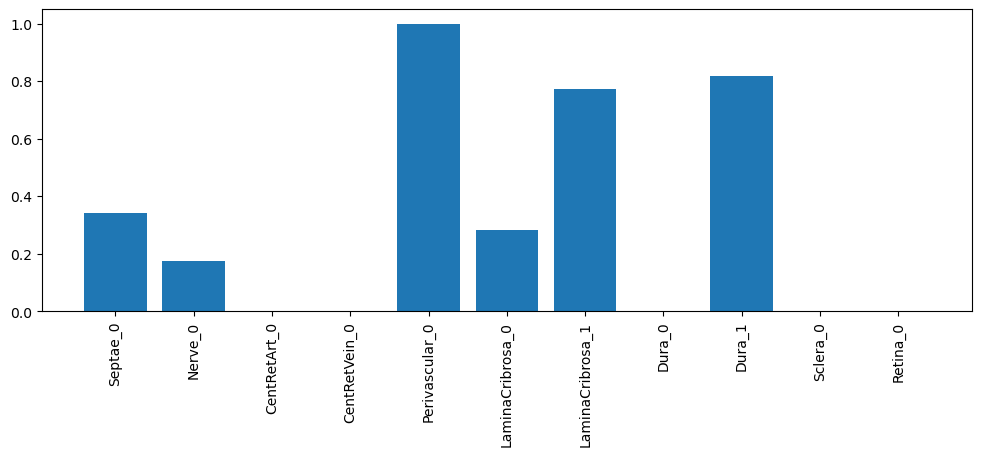

In [26]:
GENE_TO_PLOT = 'GZMK'   
    
Labels = []    
Values = []
for region in ['Septae_0',
 'Nerve_0',
 'CentRetArt_0',
 'CentRetVein_0',
 'Perivascular_0',
 'LaminaCribrosa_0',
 'LaminaCribrosa_1',
 'Dura_0',
 'Dura_1',
 'Sclera_0',
 'Retina_0',] :
        nd = normexprdensity(adata, [GENE_TO_PLOT], region)*100000
        Labels.append(region)
        Values.append(nd)

    
Values = (Values - np.min(Values))/(np.max(Values) - np.min(Values))
plt.rcParams['figure.figsize'] = [12, 4]
plt.rcParams['figure.dpi'] = 100 
plt.bar(np.arange(0,len(Labels),1), height=Values, tick_label=Labels)
plt.xticks(rotation='vertical')    
plt.show()

In [32]:
adata[adata.obs.query('n_counts > 20 and n_counts < 10 and n_genes_by_counts > 20').index]

View of AnnData object with n_obs × n_vars = 0 × 4033
    obs: 'Septae_0', 'Nerve_0', 'CentRetArt_0', 'CentRetVein_0', 'Perivascular_0', 'LaminaCribrosa_0', 'LaminaCribrosa_1', 'Dura_0', 'Dura_1', 'Sclera_0', 'Retina_0', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'n_counts'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells'
    uns: 'spatial'
    obsm: 'spatial'

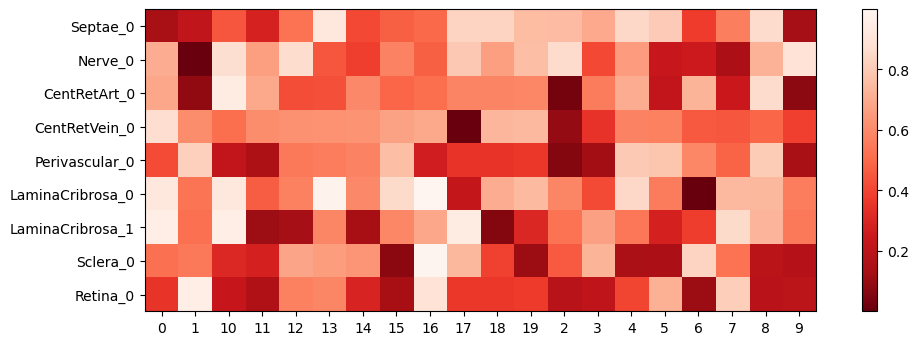

In [27]:
from scipy.stats import chisquare


def region_enrichment(adata, regionname, clustername):
    
    # Enrichment for cluster within region

    n_total = len(adata.obs[regionname])
    n_region = sum(adata.obs[regionname] > 0)

    region = adata.obs[regionname] > 0
    cluster = adata.obs['cluster_louvain'] == clustername
    n_cluster = sum(adata.obs['cluster_louvain'] == clustername)
    n_overlap = sum(region & cluster)

    f_obs = [n_overlap, n_region - n_overlap]
    f_exp = np.multiply([(n_cluster/n_total), 1-(n_cluster/n_total)], n_region)

    _,pval = chisquare(f_obs, f_exp)
    
    return(pval)

# regionname = 'Nerve_0'
# clustername = '2'

regionnames = ['Septae_0',
 'Nerve_0',
 'CentRetArt_0',
 'CentRetVein_0',
 'Perivascular_0',
 'LaminaCribrosa_0',
 'LaminaCribrosa_1',
 'Sclera_0',
 'Retina_0',]


pvals = np.zeros([len(regionnames), len(np.unique(adatam.obs['cluster_louvain']))])
r = 0

for regionname in regionnames:
    c = 0
    for clustername in np.unique(adatam.obs['cluster_louvain']):
        pvals[r,c] = region_enrichment(adatam, regionname, clustername)
        c = c + 1
        
    r = r + 1

#ax = plt.imshow(np.power(pvals,0.5), cmap='Reds_r')
ax = plt.imshow(pvals, cmap='Reds_r')
plt.colorbar()
_ = plt.xticks(np.arange(len(np.unique(adatam.obs['cluster_louvain']))), 
               labels=np.unique(adatam.obs['cluster_louvain']))
_ = plt.yticks(np.arange(len(regionnames)), labels=regionnames)

In [44]:
np.sort(pvals[:,:])

array([[0.12983659, 0.14510482, 0.21706894, 0.286429  , 0.37598759,
        0.41168886, 0.44565372, 0.47616738, 0.49814878, 0.52708599,
        0.56287283, 0.69648796, 0.75234865, 0.75352952, 0.80286637,
        0.83434476, 0.83434476, 0.84644516, 0.8615382 , 0.91756731],
       [0.00610165, 0.14979482, 0.23998824, 0.25592066, 0.38528681,
        0.41051789, 0.44628272, 0.47422684, 0.58109878, 0.65518089,
        0.66076031, 0.66356601, 0.70781836, 0.72461021, 0.75754161,
        0.79420182, 0.8603933 , 0.86391446, 0.87068921, 0.89010749],
       [0.03044929, 0.08155444, 0.08900114, 0.2217374 , 0.24827348,
        0.42489865, 0.43032538, 0.4907242 , 0.51866716, 0.55607148,
        0.5836042 , 0.5836042 , 0.59279785, 0.59542347, 0.69010123,
        0.69420138, 0.70567707, 0.72790151, 0.85920424, 0.9403514 ],
       [0.00792257, 0.09685017, 0.34598547, 0.38947121, 0.44730884,
        0.4547651 , 0.49277175, 0.51498001, 0.57106328, 0.57765535,
        0.60486156, 0.60738532, 0.62311262, 0